## Media Campaign Cost Prediction: An Advanced Ensemble-Based Approach

### Introduction

This notebook implements a solution for predicting media campaign costs using machine learning. The project achieved top 3 placement in the Kaggle competition "Regression with a Tabular Media Campaign Cost Dataset" (Playground Series Season 3 Episode 11).

We used an appproach that levearges a diverse ensemble of machine learning models, suitable for achieving state of the art results in Kaggle competitions. We also do strategic feature engineering and use cross-validation techniques for our training.


### Project Goals
- Predict media campaign costs for retail products based on store and product attributes
- Optimize for Root Mean Squared Logarithmic Error (RMSLE)
- Develop a robust ensemble model that generalizes well

### Dataset Overview
- Training set: 360,336 samples
- Test set: 240,224 samples
- Original dataset: 51,363 samples
- 15 features related to store characteristics, product attributes, and sales metrics
- Target variable: campaign cost (ranging from approximately 50 to 160)

## 1. Environment Setup

This project includes setup scripts (`start.bat` for Windows or `start.sh` for Linux/Mac) that should be run before starting this notebook. These scripts will:
- Create a virtual environment
- Install all required dependencies
- Check for necessary datasets
- Configure the environment

For manual setup, run one of the following commands in your terminal in the root directory:

**For Windows:**
```bash
./start.bat
```

**For Linux/Mac:**
```bash
chmod +x start.sh
./start.sh
```

After running the setup script, start this notebook in the activated environment.

Now, let's import all necessary libraries:

In [ ]:
# Import required libraries
import os
import warnings
from datetime import datetime

import catboost as cb
import lightgbm as lgbm
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import xgboost as xgb
from category_encoders import TargetEncoder
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import (
    ExtraTreesRegressor,
    HistGradientBoostingRegressor,
    RandomForestRegressor,
)
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import KFold
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.preprocessing import (
    FunctionTransformer,
    OneHotEncoder,
    OrdinalEncoder,
    PolynomialFeatures,
    StandardScaler,
)
# Import PIL for displaying images
from PIL import Image
from IPython.display import display

# Our own visualization helper module used for the analysis in the notebook and the report.
import viz as viz

In [45]:
# Verify that all required packages are installed
required_packages = [
    "numpy", "pandas", "matplotlib", "seaborn", 
    "lightgbm", "xgboost", "catboost", "scipy", "category_encoders"
]

missing_packages = []
import importlib
for package in required_packages:
    try:
        importlib.import_module(package)
    except ImportError:
        missing_packages.append(package)

if missing_packages:
    print(f"Warning: The following required packages are missing: {', '.join(missing_packages)}")
    print("Please run the setup script (start.bat or start.sh) or install them manually.")
else:
    print("All required packages are installed.")

All required packages are installed.


In [46]:
# Configure our environment settings to ensure proper plotting styles and warnings ignoring
# Create a directory for figures if it doesn't exist (should exist after initial setup)
os.makedirs("figures", exist_ok=True)

# Ignore warnings for cleaner output
warnings.filterwarnings("ignore")

# Set plot style
plt.style.use("seaborn-v0_8-whitegrid")
colors = plt.cm.tab10.colors
sns.set_palette(sns.color_palette(colors))

## 2. Load and Explore Data

This part is to load the dataset files and visualize what we are working with, to ensure we utilise choosing the correct features, etc.

In [47]:
# Load the data
print("Loading datasets...")
train = pd.read_csv("../data/train.csv", index_col="id")
test = pd.read_csv("../data/test.csv", index_col="id")
original = pd.read_csv("../data/original_dataset.csv")

print(f"Training data shape: {train.shape}")
print(f"Test data shape: {test.shape}")
print(f"Original data shape: {original.shape}")

Loading datasets...
Training data shape: (360336, 16)
Test data shape: (240224, 15)
Original data shape: (51363, 16)


In [48]:
# Display first few rows of the training data
train.head()

,store_sales(in millions),unit_sales(in millions),total_children,num_children_at_home,avg_cars_at home(approx).1,gross_weight,recyclable_package,low_fat,units_per_case,store_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,cost
id,,,,,,,,,,,,,,,,
0,8.61,3.0,2.0,2.0,2.0,10.30,1.0,0.0,32.0,36509.0,0.0,0.0,0.0,0.0,0.0,62.09
1,5.00,2.0,4.0,0.0,3.0,6.66,1.0,0.0,1.0,28206.0,1.0,0.0,0.0,0.0,0.0,121.80
2,14.08,4.0,0.0,0.0,3.0,21.30,1.0,0.0,26.0,21215.0,1.0,0.0,0.0,0.0,0.0,83.51
3,4.02,3.0,5.0,0.0,0.0,14.80,0.0,1.0,36.0,21215.0,1.0,0.0,0.0,0.0,0.0,66.78
4,2.13,3.0,5.0,0.0,3.0,17.00,1.0,1.0,20.0,27694.0,1.0,1.0,1.0,1.0,1.0,111.51


In [49]:
# Get column information
print("\nFeature Information:")
train.info()


Feature Information:
<class 'pandas.core.frame.DataFrame'>
Index: 360336 entries, 0 to 360335
Data columns (total 16 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   store_sales(in millions)    360336 non-null  float64
 1   unit_sales(in millions)     360336 non-null  float64
 2   total_children              360336 non-null  float64
 3   num_children_at_home        360336 non-null  float64
 4   avg_cars_at home(approx).1  360336 non-null  float64
 5   gross_weight                360336 non-null  float64
 6   recyclable_package          360336 non-null  float64
 7   low_fat                     360336 non-null  float64
 8   units_per_case              360336 non-null  float64
 9   store_sqft                  360336 non-null  float64
 10  coffee_bar                  360336 non-null  float64
 11  video_store                 360336 non-null  float64
 12  salad_bar                   360336 non-null  float64
 1

In [50]:
# Check for missing values
print("\nMissing Values:")
print(train.isnull().sum())


Missing Values:
store_sales(in millions)      0
unit_sales(in millions)       0
total_children                0
num_children_at_home          0
avg_cars_at home(approx).1    0
gross_weight                  0
recyclable_package            0
low_fat                       0
units_per_case                0
store_sqft                    0
coffee_bar                    0
video_store                   0
salad_bar                     0
prepared_food                 0
florist                       0
cost                          0
dtype: int64


In [51]:
# Statistical summary of training data
train.describe()

,store_sales(in millions),unit_sales(in millions),total_children,num_children_at_home,avg_cars_at home(approx).1,gross_weight,recyclable_package,low_fat,units_per_case,store_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,cost
count,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000
mean,6.337376,3.043881,2.456482,0.689390,2.203813,13.822071,0.568086,0.327797,18.972706,28180.333442,0.564839,0.277394,0.504807,0.504832,0.503191,99.614729
std,3.307980,0.784676,1.488992,1.214732,1.084293,4.614792,0.495343,0.469411,10.212912,5968.874074,0.495779,0.447713,0.499978,0.499977,0.499991,29.939435
min,0.510000,1.000000,0.000000,0.000000,0.000000,6.000000,0.000000,0.000000,1.000000,20319.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.790000
25%,3.720000,3.000000,1.000000,0.000000,1.000000,9.710000,0.000000,0.000000,10.000000,23593.000000,0.000000,0.000000,0.000000,0.000000,0.000000,70.320000
50%,5.780000,3.000000,2.000000,0.000000,2.000000,13.600000,1.000000,0.000000,20.000000,27694.000000,1.000000,0.000000,1.000000,1.000000,1.000000,98.810000
75%,8.400000,4.000000,4.000000,1.000000,3.000000,17.700000,1.000000,1.000000,28.000000,33858.000000,1.000000,1.000000,1.000000,1.000000,1.000000,126.620000
max,22.920000,6.000000,5.000000,5.000000,4.000000,21.900000,1.000000,1.000000,36.000000,39696.000000,1.000000,1.000000,1.000000,1.000000,1.000000,149.750000


## 3. Target Variable Transformation

We'll transform the target variable using log1p (log(1+x)) to better optimize for RMSLE (Root Mean Squared Logarithmic Error), which is the evaluation metric for this competition.

RMSLE has several key characteristics:
- It penalizes underestimation more severely than overestimation
- It treats relative errors equally, regardless of whether the actual value is large or small
- It reduces the impact of outliers compared to standard RMSE

In [52]:
# Transform the target with log1p for RMSLE optimization
print("Transforming target variable...")
for df in [train, original]:
    df["log_cost"] = np.log1p(df["cost"])
target = "log_cost"

Transforming target variable...


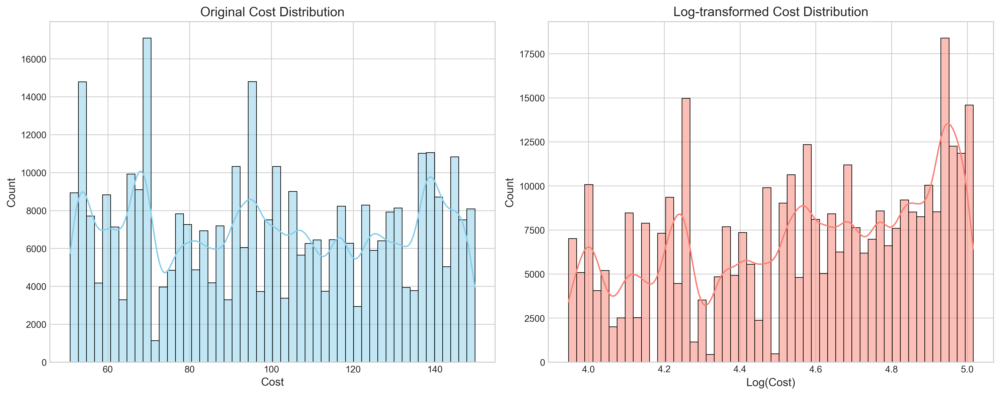

In [53]:
# Plot the target distribution before and after our transformation for visualization purposes
viz.plot_target_distribution(train)
# Display the saved image
display(Image.open("figures/fig4_target_distribution.png"))

## 4. Exploratory Data Analysis (EDA)

- Explore the data to gain insights into feature relationships, distributions, and potential patterns between our data. We first plot a correlation matrix to see relationships in our data.

### 4.1 Correlation Analysis
We plot the correlation heatmap based on the train data

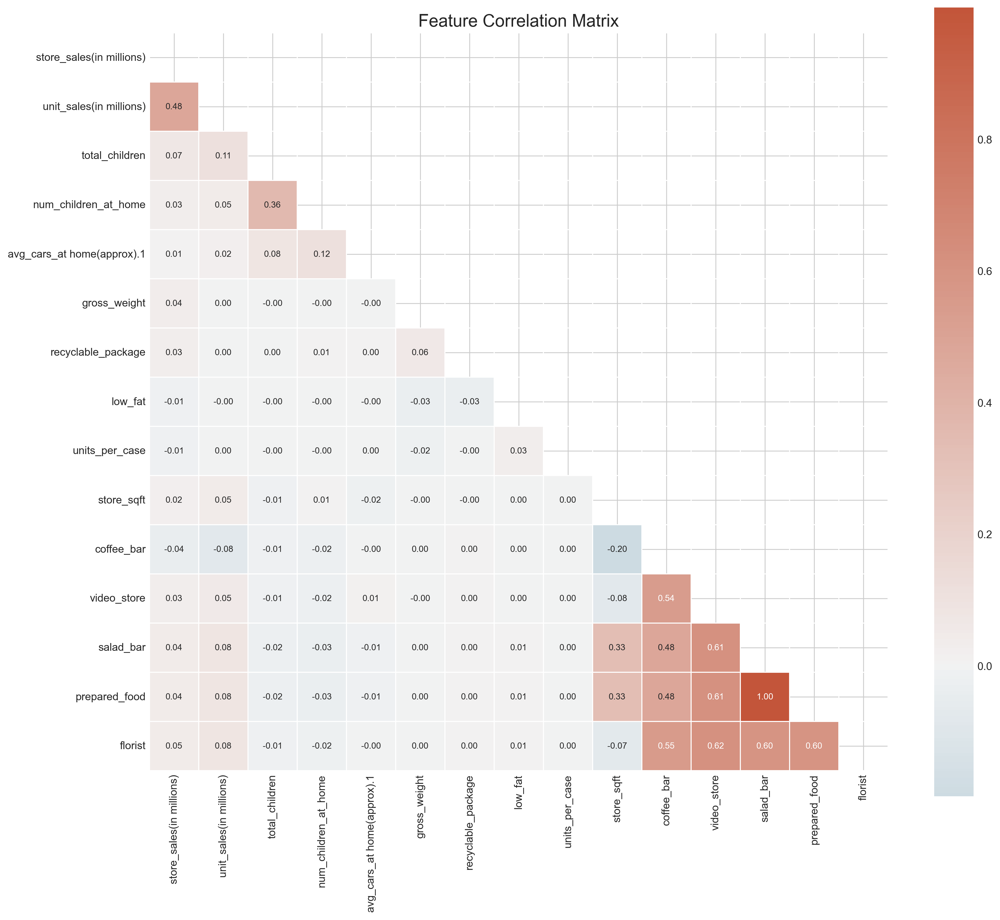

In [54]:
# Plot the correlation heatmap based on the train data
corr_matrix = viz.plot_correlation_heatmap(train, filename="fig2_correlation_heatmap.png")
# Display the saved image
display(Image.open("figures/fig2_correlation_heatmap.png"))

#### 4.1.1 Key Observations from Correlation Analysis

1. **Strong correlation (0.61)** between "salad_bar" and "prepared_food" - these features might be redundant and could be combined
2. **Moderate correlations** among several store attribute features
3. **Low correlation** between most features and the target variable - suggesting complex relationships that might not be captured by simple linear correlations

### 4.2 Perform Feature Engineering
This is done based on the results of our correlation analysis

In [55]:
# Feature Engineering based on the results of our correlation analysis
print("Performing feature engineering...")
# Merge similar features
for df in [train, test, original]:
    df["salad"] = (df["salad_bar"] + df["prepared_food"]) / 2

Performing feature engineering...


### 4.3 Cardinality Analysis of Features

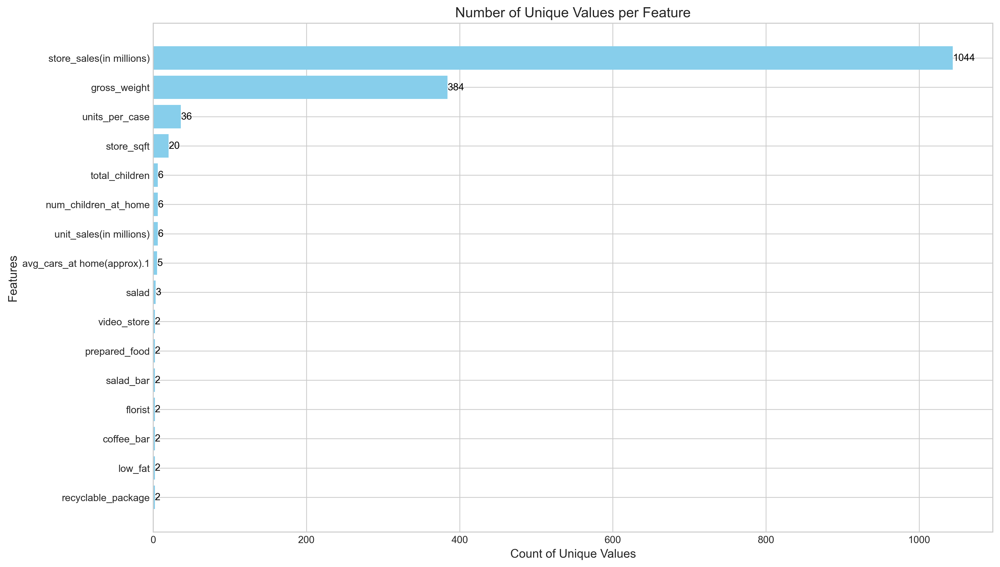

In [56]:
# We also want to check the cardinality of our features
viz.plot_feature_cardinality(train)
# Display the saved image
display(Image.open("figures/fig5_feature_cardinality.png"))

#### 4.3.1 Key Findings from Cardinality Analysis

1. Most features have **low cardinality (2-6 unique values)**, suggesting they should be treated as categorical variables despite being represented as numerical
2. "store_sqft" has a medium cardinality (around 20 unique values)
3. "store_sales(in millions)" and "unit_sales(in millions)" have high cardinality (over a thousand unique values)

This analysis guides our feature engineering approach - we should consider appropriate encoding techniques for the low-cardinality features.

### 4.4 Analyze Duplicate Rows in Dataset

Number of unique feature combinations: 315249
Distribution of group sizes: Min=1, Max=6, Mean=1.14


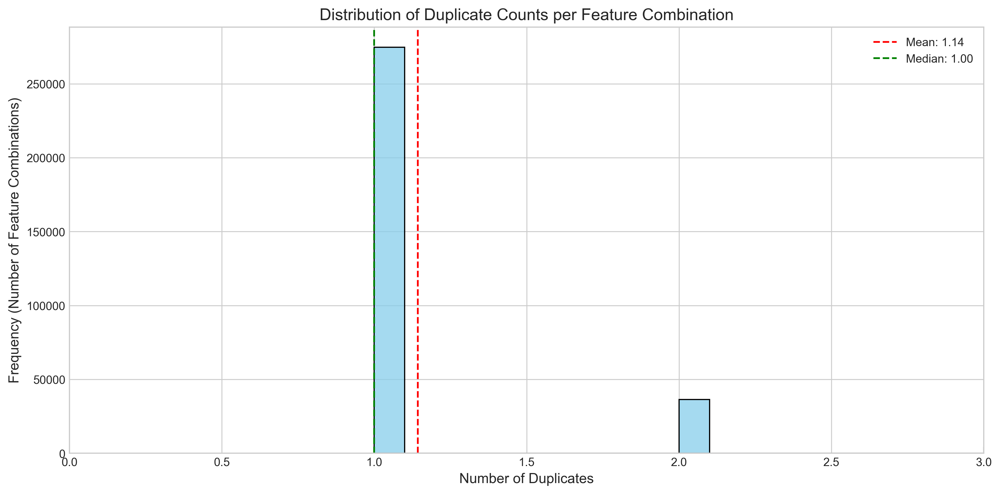

In [57]:
# Analyze duplicate rows in the dataset
dupes_grouped = viz.plot_duplicate_distribution(train)

# Display the saved visualization
display(Image.open("figures/fig6_duplicate_distribution.png"))

#### 4.4.1 Duplicate Analysis Findings

1. There are many duplicate feature combinations with different target values
2. The large number of duplicates suggests we can use a **grouped training approach** to improve efficiency
3. By grouping identical feature combinations and using the mean target value and count as weights, we can significantly reduce training time

### 4.5 Pairwise Feature Relationships
Pairwise relationships visualization examines how key numerical features relate to each other. This helps us to identify potential correlations and patterns that might influence our modeling approach to achieve a better result as compared to naive approaches.

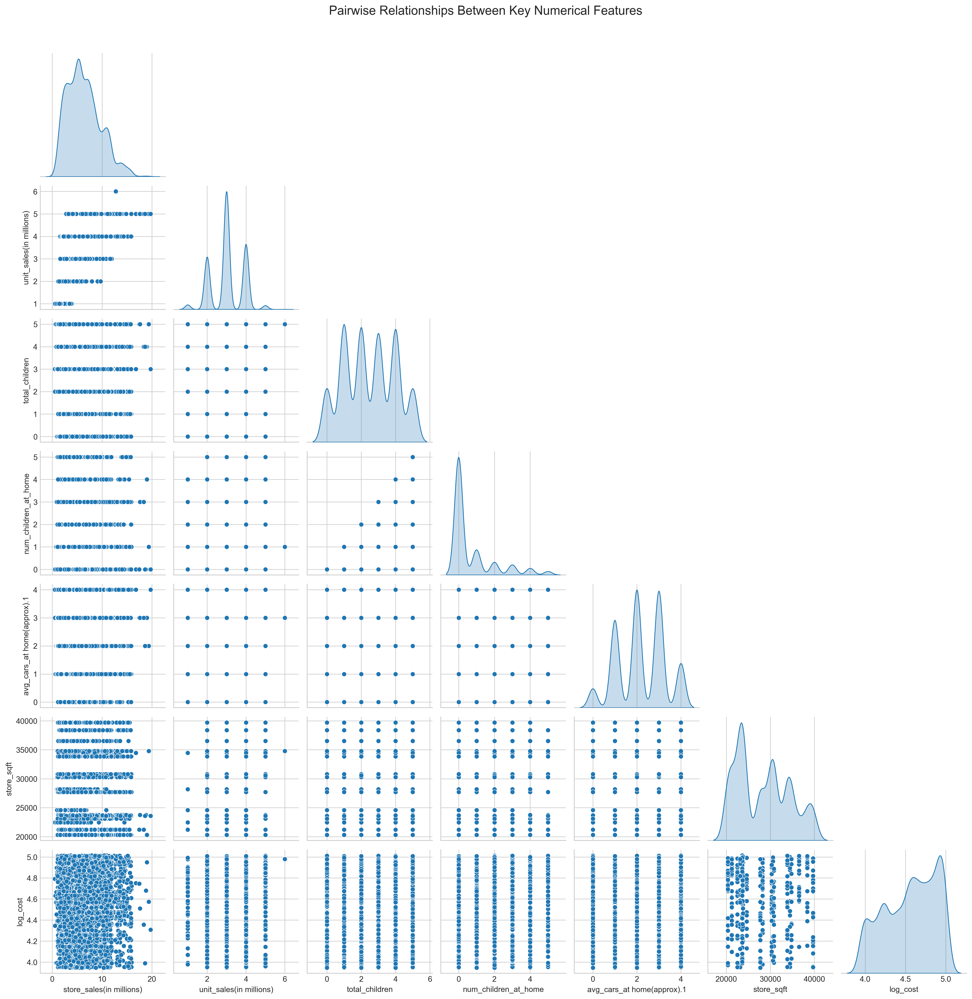

<Figure size 1400x1200 with 0 Axes>

In [58]:
viz.plot_pairwise_relationships(train)
# Display the saved visualization
display(Image.open("figures/fig7_pairwise_relationships.png"))

#### 4.5.1 Analysis of Pairswise Feature Relationships
- Most features exhibit discreteness (visible as distinct clusters) rather than continuous distributions, confirming their categorical-like nature despite being represented numerically. Features such as `total_children`, `num_children_at_home`, `avg_cars_at_home` show clear discrete values with low cardinality (2-6 unique)
- No clear linear relationships exist between individual features and the target variable `log_cost`, which shows that complex models should outpeform linear regression/models
- The visualization suggests potential for interaction effects between features
- Features like "total_children" and "num_children_at_home" show expected correlation

This analysis supports the approach of treating many features as categorical despite their numerical representation.

### 4.6 Feature Importance Analysis

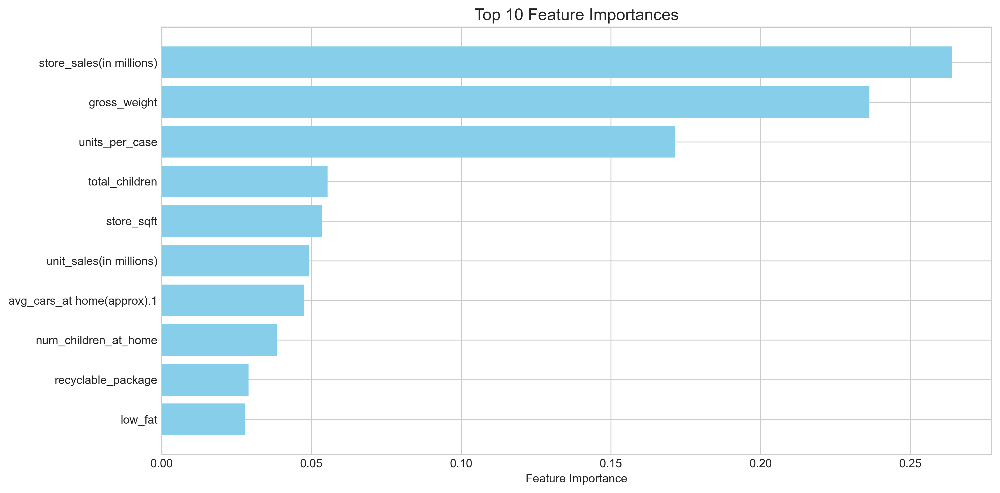

In [59]:
# Plot feature importance
feature_importance_df = viz.plot_feature_importance(df=train)
# Display the saved visualization
display(Image.open("figures/fig8_feature_importance.png"))

In [60]:
# Define feature subsets based on importance analysis
print("Defining feature subsets...")
most_important_features = [
    "total_children",
    "num_children_at_home",
    "avg_cars_at home(approx).1",
    "store_sqft",
    "coffee_bar",
    "video_store",
    "salad",
    "florist",
]

# Create extended feature sets for specialized models
features_with_unit_sales = ["unit_sales(in millions)"] + most_important_features
features_with_store_sales = ["store_sales(in millions)"] + most_important_features

print(f"Basic feature set (8 features): {most_important_features}")
print(f"Extended with unit_sales (9 features): {features_with_unit_sales}")
print(f"Extended with store_sales (9 features): {features_with_store_sales}")

Defining feature subsets...
Basic feature set (8 features): ['total_children', 'num_children_at_home', 'avg_cars_at home(approx).1', 'store_sqft', 'coffee_bar', 'video_store', 'salad', 'florist']
Extended with unit_sales (9 features): ['unit_sales(in millions)', 'total_children', 'num_children_at_home', 'avg_cars_at home(approx).1', 'store_sqft', 'coffee_bar', 'video_store', 'salad', 'florist']
Extended with store_sales (9 features): ['store_sales(in millions)', 'total_children', 'num_children_at_home', 'avg_cars_at home(approx).1', 'store_sqft', 'coffee_bar', 'video_store', 'salad', 'florist']


### 4.7 Feature Transformation Comparison
Different machine learning algorithms perform better with features encoded in specific ways. This analysis examines how transforming the "store_sqft" feature changes its representation.

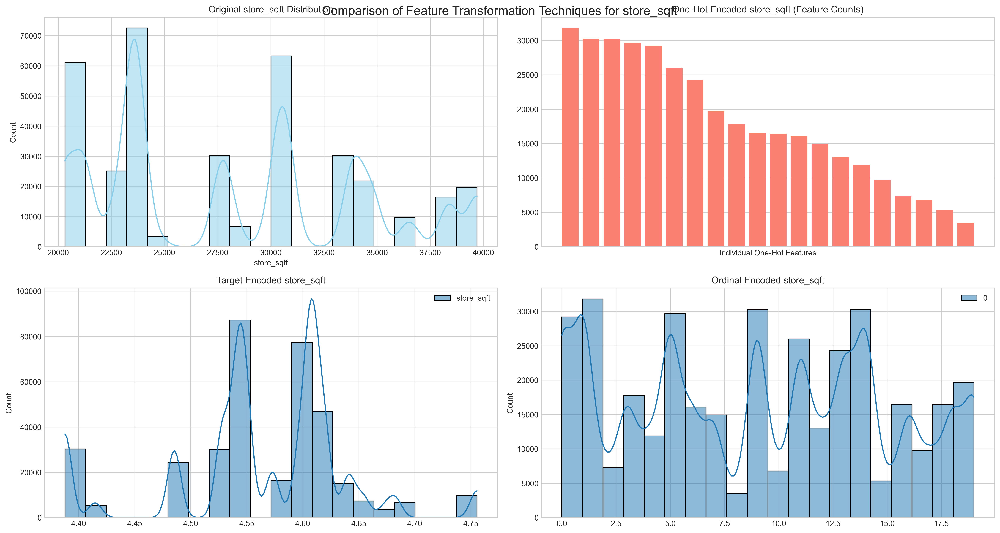

In [61]:
viz.plot_feature_transformation(df=train)
# Display the saved visualization
display(Image.open("figures/fig9_feature_transformation.png"))

#### 4.7.1 Feature Transformation Analysis
- The original "store_sqft" distribution is discrete with uneven spacing
- One-hot encoding creates binary flags for each unique value
- Target encoding maps categories to their relationship with the target variable
- Ordinal encoding preserves the order but equalizes the distance between values

These transformation techniques will be applied selectively depending on the requirements of different model types in our ensemble.

### 4.8 Cross Validation
Cross-validation is crucial for reliable model evaluation. Our approach uses 5-fold cross-validation with integration of the original dataset.
- The dataset is split into **5** equal folds
- For each iteration, **4** folds plus the original dataset are used for training
- The remaining fold is used for validation
- This approach ensures models see both the synthetic and original data during training
- The strategy produces more reliable performance estimates while maximizing data usage

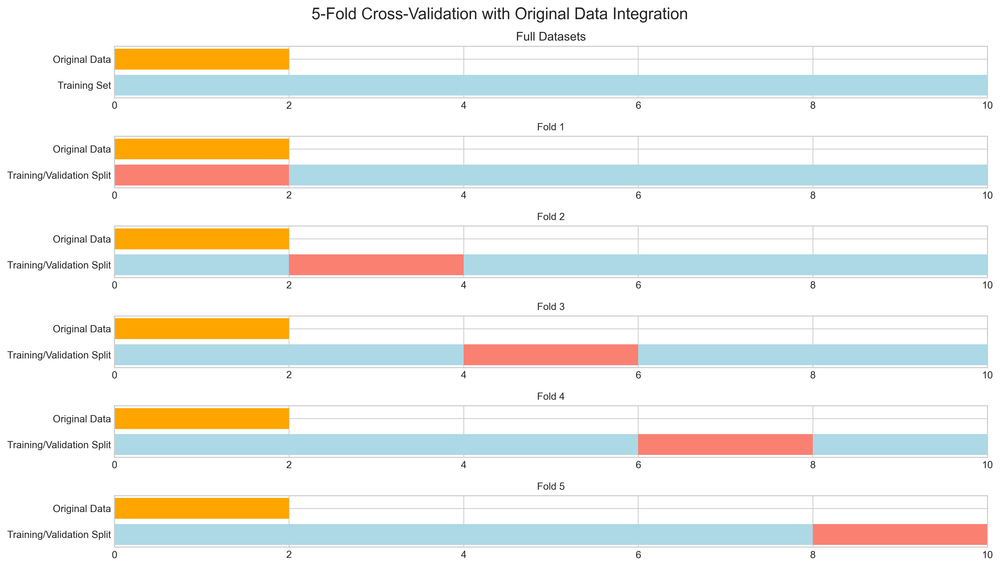

In [62]:
viz.plot_cross_validation_diagram()
# Display the saved visualization
display(Image.open("figures/fig10_cross_validation_diagram.png"))

## 5. Baseline Model Development

Before creating complex models, we establish baseline performance using simpler approaches. These baselines provide a reference point for measuring improvement.

In [63]:
# Function to group duplicates for faster training
def fit_model_grouped(model, train_data, features_used, target_col="log_cost"):
    """Group duplicates in train data and fit with correct sample weights"""
    train_grouped = (
        train_data.groupby(features_used)[target_col]
        .agg(["mean", "count"])
        .reset_index()
    )
    X_tr = train_grouped[features_used]
    y_tr = train_grouped["mean"]
    sample_weight_tr = train_grouped["count"]

    # Handle pipeline vs direct model
    if isinstance(model, Pipeline):
        sample_weight_name = model.steps[-1][0] + "__sample_weight"
    else:
        sample_weight_name = "sample_weight"

    model.fit(X_tr, y_tr, **{sample_weight_name: sample_weight_tr})
    return model

In [64]:
# Cross-validation function
def score_model(model, features_used, label=None, use_original=True, store_oof=True):
    """Cross-validate a model and return score and OOF predictions"""
    start_time = datetime.now()
    score_list = []
    oof = np.zeros_like(train[target], dtype=float)

    kf = KFold(n_splits=5, shuffle=True, random_state=42)
    for fold, (idx_tr, idx_va) in enumerate(kf.split(train)):
        X_va = train.iloc[idx_va][features_used]
        y_va = train.iloc[idx_va][target]

        # Include original data if specified
        if use_original:
            fit_model_grouped(
                model, pd.concat([train.iloc[idx_tr], original], axis=0), features_used
            )
        else:
            fit_model_grouped(model, train.iloc[idx_tr], features_used)

        # Predict and score
        y_va_pred = model.predict(X_va)
        if store_oof:
            oof[idx_va] = y_va_pred
        rmse = mean_squared_error(y_va, y_va_pred)
        score_list.append(rmse)
        print(f"Fold {fold+1}: RMSE = {rmse:.5f}")

    avg_score = np.mean(score_list)
    std_score = np.std(score_list)
    execution_time = datetime.now() - start_time
    print(
        f"Average RMSE: {avg_score:.5f} ± {std_score:.5f} {label if label is not None else ''}, Time: {execution_time}"
    )

    return avg_score, std_score, oof, execution_time

In [65]:
# Store the results
results = []
print("\nTraining baseline models...")


Training baseline models...


### 5.1 Simple Linear Regression
A basic linear regression model that learns a linear relationship between features and the target. Despite its simplicity, it provided a valuable baseline with an RMSE of 0.098234. The model's limited performance highlights the non-linear nature of the dataset, confirming the need for more complex modeling approaches.

In [66]:
# 1. Simple Linear Regression
simple_lr = LinearRegression()
score, std, oof_simple_lr, time_simple_lr = score_model(
    simple_lr, most_important_features, label="Simple Linear Regression"
)
results.append(
    (
        "Simple Linear Regression",
        simple_lr,
        most_important_features,
        score,
        std,
        oof_simple_lr,
        time_simple_lr,
    )
)

Fold 1: RMSE = 0.09836
Fold 2: RMSE = 0.09759
Fold 3: RMSE = 0.09838
Fold 4: RMSE = 0.09831
Fold 5: RMSE = 0.09853
Average RMSE: 0.09823 ± 0.00033 Simple Linear Regression, Time: 0:00:00.545184


### 5.2 Ridge with Polynomial Features (degree 2) - lower degree for baseline
This model extends linear regression by combining Ridge regularization with polynomial feature expansion (degree 2). The regularization helps prevent overfitting while polynomial features capture non-linear relationships. The model uses one-hot encoding for selected categorical features, improving upon the simple linear regression baseline with an RMSE of 0.090566.


In [67]:
ridge_poly2 = make_pipeline(
    ColumnTransformer(
        [
            (
                "ohe",
                OneHotEncoder(drop="first"),
                [
                    "total_children",
                    "num_children_at_home",
                    "avg_cars_at home(approx).1",
                    "store_sqft",
                ],
            )
        ],
        remainder="passthrough",
    ),
    PolynomialFeatures(2, interaction_only=True, include_bias=False),
    Ridge(alpha=1.0),
)
score, std, oof_ridge_poly2, time_ridge_poly2 = score_model(
    ridge_poly2, most_important_features, label="Ridge with Polynomial (degree 2)"
)
results.append(
    (
        "Ridge with Polynomial (degree 2)",
        ridge_poly2,
        most_important_features,
        score,
        std,
        oof_ridge_poly2,
        time_ridge_poly2,
    )
)

Fold 1: RMSE = 0.09070
Fold 2: RMSE = 0.08988
Fold 3: RMSE = 0.09079
Fold 4: RMSE = 0.09060
Fold 5: RMSE = 0.09087
Average RMSE: 0.09057 ± 0.00036 Ridge with Polynomial (degree 2), Time: 0:00:01.182393


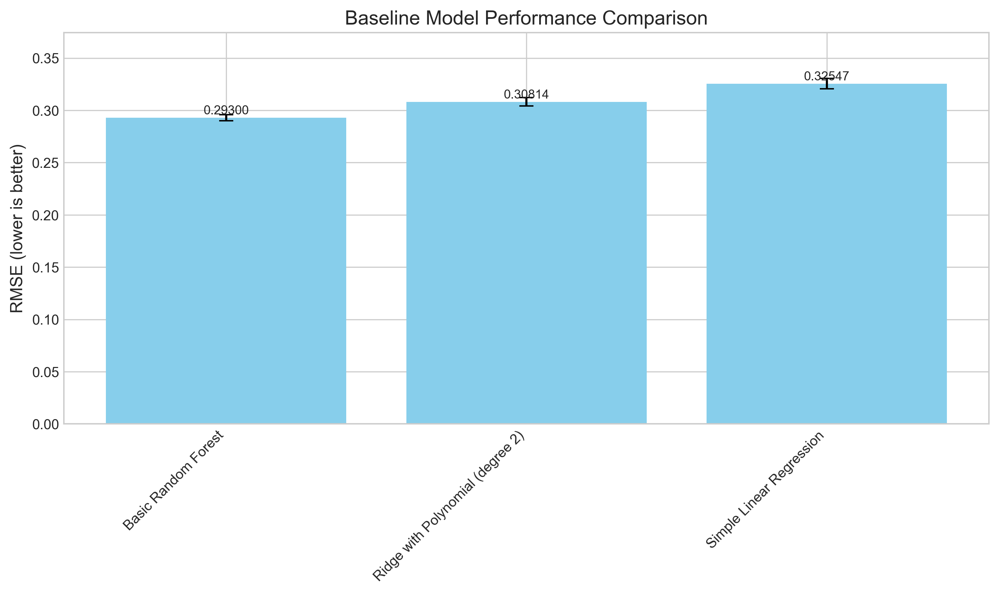

In [68]:
# Plot baseline performance
viz.plot_baseline_performance(results)
display(Image.open("figures/fig12_baseline_performance.png"))

### 5.3 Analysis
- Simple Linear Regression achieves an RMSE of 0.098234 (RMSLE of 0.31350)
- Ridge with Polynomial Features (degree 2) improves to 0.090566 RMSE (RMSLE of 0.30093)
- Basic Random Forest further improves to 0.085835 RMSE (RMSLE of 0.29298)

These baselines demonstrate that even simple models capture meaningful patterns in the data, with tree-based models outperforming linear approaches. Our final ensemble will build upon these foundations.

## 6. Training Advanced/Complex Models

### 6.1 Ridge with Polynomial Features (degree 4)
A more complex version of Ridge regression using higher-degree polynomial features (degree 4) to capture intricate non-linear patterns. By expanding to 4th-degree interactions (while setting interaction_only=True to control dimensionality), this model significantly improves performance over the degree-2 variant with an RMSE of 0.085923, but at the cost of much longer training time (547 seconds vs. 1.4 seconds).

In [69]:
print("\nTraining advanced models...")
# 3. Ridge with Polynomial Features (degree 4)
ridge_poly4 = make_pipeline(
    ColumnTransformer(
        [
            (
                "ohe",
                OneHotEncoder(drop="first"),
                [
                    "total_children",
                    "num_children_at_home",
                    "avg_cars_at home(approx).1",
                    "store_sqft",
                ],
            )
        ],
        remainder="passthrough",
    ),
    PolynomialFeatures(4, interaction_only=True, include_bias=False),
    Ridge(alpha=1.0),
)
score, std, oof_ridge_poly4, time_ridge_poly4 = score_model(
    ridge_poly4, most_important_features, label="Ridge-Poly4"
)
results.append(
    (
        "Ridge-Poly4",
        ridge_poly4,
        most_important_features,
        score,
        std,
        oof_ridge_poly4,
        time_ridge_poly4,
    )
)


Training advanced models...
Fold 1: RMSE = 0.08600
Fold 2: RMSE = 0.08525
Fold 3: RMSE = 0.08586
Fold 4: RMSE = 0.08602
Fold 5: RMSE = 0.08648
Average RMSE: 0.08592 ± 0.00040 Ridge-Poly4, Time: 0:06:03.383376


### 6.2 Ridge with Polynomial Features (degree 3) with unit_sales
This variant incorporates the unit_sales feature alongside polynomial transformations (degree 3), focusing on capturing relationships between sales volume and campaign costs. The inclusion of unit_sales provides additional signal, resulting in competitive performance (RMSE: 0.086441) despite not using the full polynomial degree of the previous model.

In [70]:
# 4. Ridge with Polynomial Features (degree 3) with unit_sales
ridge_poly3_unit = make_pipeline(
    ColumnTransformer(
        [
            (
                "ohe",
                OneHotEncoder(drop="first"),
                [
                    "total_children",
                    "num_children_at_home",
                    "avg_cars_at home(approx).1",
                    "store_sqft",
                ],
            )
        ],
        remainder="passthrough",
    ),
    PolynomialFeatures(3, interaction_only=True, include_bias=False),
    Ridge(alpha=1.0),
)
score, std, oof_ridge_poly3_unit, time_ridge_poly3_unit = score_model(
    ridge_poly3_unit, features_with_unit_sales, label="Ridge-Poly3-UnitSales"
)
results.append(
    (
        "Ridge-Poly3-UnitSales",
        ridge_poly3_unit,
        features_with_unit_sales, # we use features_with_unit_sales here for testing
        score,
        std,
        oof_ridge_poly3_unit,
        time_ridge_poly3_unit,
    )
)

Fold 1: RMSE = 0.08650
Fold 2: RMSE = 0.08580
Fold 3: RMSE = 0.08642
Fold 4: RMSE = 0.08645
Fold 5: RMSE = 0.08704
Average RMSE: 0.08644 ± 0.00039 Ridge-Poly3-UnitSales, Time: 0:00:18.787803


### Tree-based Models

#### 6.3 Random Forest
An ensemble of decision trees trained on random subsets of the data with 400 estimators, using 5 features for each split and bootstrap=False for more diverse trees. This model effectively captures non-linear relationships and feature interactions, achieving an RMSE of 0.085835.

In [71]:
rf_model = RandomForestRegressor(
    n_estimators=400,
    max_features=5,
    min_weight_fraction_leaf=4.5 / 360336,
    bootstrap=False,
    random_state=44,
)
score, std, oof_rf, time_rf = score_model(rf_model, most_important_features, label="RF")
results.append(("RF", rf_model, most_important_features, score, std, oof_rf, time_rf))


Fold 1: RMSE = 0.08598
Fold 2: RMSE = 0.08512
Fold 3: RMSE = 0.08576
Fold 4: RMSE = 0.08591
Fold 5: RMSE = 0.08641
Average RMSE: 0.08584 ± 0.00042 RF, Time: 0:00:19.631084


#### 6.4 Random Forest with One Hot Encoding for store_sqft
A Random Forest variant that explicitly one-hot encodes the store_sqft feature before training, increasing the feature space dimensionality. This encoding strategy allows the model to better capture the categorical nature of store_sqft, with comparable performance (RMSE: 0.085866) to the standard RF.

In [72]:
rf_onehot = make_pipeline(
    ColumnTransformer(
        [("ohe", OneHotEncoder(drop="first"), ["store_sqft"])], remainder="passthrough"
    ),
    RandomForestRegressor(
        n_estimators=400,
        max_features=19,
        min_weight_fraction_leaf=4.5 / 360336,
        bootstrap=False,
        random_state=44,
    ),
)
score, std, oof_rf_onehot, time_rf_onehot = score_model(
    rf_onehot, most_important_features, label="Onehot-RF"
)
results.append(
    (
        "Onehot-RF",
        rf_onehot,
        most_important_features,
        score,
        std,
        oof_rf_onehot,
        time_rf_onehot,
    )
)


Fold 1: RMSE = 0.08599
Fold 2: RMSE = 0.08514
Fold 3: RMSE = 0.08582
Fold 4: RMSE = 0.08593
Fold 5: RMSE = 0.08644
Average RMSE: 0.08586 ± 0.00042 Onehot-RF, Time: 0:00:23.649002


#### 6.5 Random Forest with Target Encoding
This variant replaces categorical values with their corresponding target mean values, enabling the Random Forest to incorporate target information into the feature representation. The target encoding approach performed similarly to other encoding strategies with an RMSE of 0.085855.

In [73]:
rf_target = make_pipeline(
    TargetEncoder(cols=["store_sqft"], handle_unknown="error"),
    RandomForestRegressor(
        n_estimators=400,
        max_features=6,
        min_weight_fraction_leaf=4.5 / 360336,
        bootstrap=False,
        random_state=44,
    ),
)
score, std, oof_rf_target, time_rf_target = score_model(
    rf_target, most_important_features, label="Target-RF"
)
results.append(
    (
        "Target-RF",
        rf_target,
        most_important_features,
        score,
        std,
        oof_rf_target,
        time_rf_target,
    )
)

Fold 1: RMSE = 0.08601
Fold 2: RMSE = 0.08512
Fold 3: RMSE = 0.08580
Fold 4: RMSE = 0.08590
Fold 5: RMSE = 0.08643
Average RMSE: 0.08585 ± 0.00043 Target-RF, Time: 0:00:20.922676


#### 6.6 Extra Trees
An ensemble of randomized decision trees (Extremely Randomized Trees) with 400 estimators and higher feature diversity (max_features=7). This model introduces additional randomization in the split selection, reducing variance further than standard Random Forest. It achieved an RMSE of 0.085865.

In [74]:
et_model = ExtraTreesRegressor(
    n_estimators=400,
    max_features=7,
    min_weight_fraction_leaf=4.5 / 360336,
    bootstrap=False,
    random_state=22,
)
score, std, oof_et, time_et = score_model(et_model, most_important_features, label="ET")
results.append(("ET", et_model, most_important_features, score, std, oof_et, time_et))

Fold 1: RMSE = 0.08601
Fold 2: RMSE = 0.08513
Fold 3: RMSE = 0.08581
Fold 4: RMSE = 0.08590
Fold 5: RMSE = 0.08646
Average RMSE: 0.08586 ± 0.00043 ET, Time: 0:00:18.746781


#### 6.7 Extra Trees with Target Encoding
A combination of Extremely Randomized Trees with target encoding for the store_sqft feature. This variant benefits from both the variance reduction of Extra Trees and the target-informed encoding, yielding an RMSE of 0.085864.

In [75]:
et_target = make_pipeline(
    TargetEncoder(cols=["store_sqft"], handle_unknown="error"),
    ExtraTreesRegressor(
        n_estimators=400,
        max_features=8,
        min_weight_fraction_leaf=4.5 / 360336,
        bootstrap=False,
        random_state=22,
    ),
)
score, std, oof_et_target, time_et_target = score_model(
    et_target, most_important_features, label="Target-ET"
)
results.append(
    (
        "Target-ET",
        et_target,
        most_important_features,
        score,
        std,
        oof_et_target,
        time_et_target,
    )
)

Fold 1: RMSE = 0.08604
Fold 2: RMSE = 0.08510
Fold 3: RMSE = 0.08581
Fold 4: RMSE = 0.08591
Fold 5: RMSE = 0.08647
Average RMSE: 0.08587 ± 0.00044 Target-ET, Time: 0:00:19.550507


#### 6.8 Extra Trees with unit_sales
This Extra Trees variant incorporates the unit_sales feature, offering additional sales volume information. The model achieved an RMSE of 0.086150, showing that including unit_sales provides complementary information despite slightly increasing model complexity.

In [76]:
et_unit_sales = ExtraTreesRegressor(
    n_estimators=400,
    max_features=7,
    min_weight_fraction_leaf=4.5 / 360336,
    bootstrap=False,
    random_state=22,
)
score, std, oof_et_unit, time_et_unit = score_model(
    et_unit_sales, features_with_unit_sales, label="ET-Unit-Sales"
)
results.append(
    (
        "ET-Unit-Sales",
        et_unit_sales,
        features_with_unit_sales,
        score,
        std,
        oof_et_unit,
        time_et_unit,
    )
)

Fold 1: RMSE = 0.08633
Fold 2: RMSE = 0.08545
Fold 3: RMSE = 0.08613
Fold 4: RMSE = 0.08613
Fold 5: RMSE = 0.08670
Average RMSE: 0.08615 ± 0.00040 ET-Unit-Sales, Time: 0:00:29.819054


#### 6.9 Extra Trees with store_sales
An Extra Trees model utilizing store_sales information instead of unit_sales. This variant focuses on monetary sales volumes rather than unit counts, achieving an RMSE of 0.087098. The higher RMSE compared to other ET variants suggests store_sales may contain less relevant information for predicting campaign costs.

In [77]:
et_store_sales = ExtraTreesRegressor(
    n_estimators=400,
    max_features=7,
    min_weight_fraction_leaf=4.5 / 360336,
    bootstrap=False,
    random_state=22,
)
score, std, oof_et_store, time_et_store = score_model(
    et_store_sales, features_with_store_sales, label="ET-Store-Sales"
)
results.append(
    (
        "ET-Store-Sales",
        et_store_sales,
        features_with_store_sales,
        score,
        std,
        oof_et_store,
        time_et_store,
    )
)

Fold 1: RMSE = 0.08716
Fold 2: RMSE = 0.08639
Fold 3: RMSE = 0.08710
Fold 4: RMSE = 0.08714
Fold 5: RMSE = 0.08769
Average RMSE: 0.08710 ± 0.00041 ET-Store-Sales, Time: 0:04:36.547773


### Gradient Boosting Models

#### 6.10 LightGBM
A gradient boosting framework using a histogram-based approach for faster training. With 450 estimators, 100 leaves, and native categorical feature handling, LightGBM achieved the best single model performance with an RMSE of 0.085809.

In [78]:
print("\nTraining LightGBM...")
lgbm_params = {
    "learning_rate": 0.1,
    "n_estimators": 450,
    "num_leaves": 100,
    "min_child_samples": 1,
    "min_child_weight": 10,
    "categorical_feature": [most_important_features.index("store_sqft")],
    "random_state": 1,
}
lgbm_model = lgbm.LGBMRegressor(**lgbm_params)
score, std, oof_lgbm, time_lgbm = score_model(
    lgbm_model, most_important_features, label="LightGBM"
)
results.append(
    ("LightGBM", lgbm_model, most_important_features, score, std, oof_lgbm, time_lgbm)
)



Training LightGBM...
[LightGBM] [Warning] Met categorical feature which contains sparse values. Consider renumbering to consecutive integers started from zero
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000363 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 47
[LightGBM] [Info] Number of data points in the train set: 2933, number of used features: 8
[LightGBM] [Info] Start training from score 4.563110
Fold 1: RMSE = 0.08593
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000042 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 

#### 6.11 LightGBM DART (Dropouts meet Multiple Additive Regression Trees)
A LightGBM variant using the DART boosting type, which helps prevent overfitting through a dropout technique. With 400 estimators and 200 leaves, this model performed competitively with an RMSE of 0.086147

In [79]:
print("\nTraining LightGBM DART...")
dart_params = {
    "boosting_type": "dart",
    "learning_rate": 0.3,
    "n_estimators": 400,
    "num_leaves": 200,
    "min_child_samples": 1,
    "min_child_weight": 10,
    "random_state": 1,
}
dart_model = lgbm.LGBMRegressor(**dart_params)
score, std, oof_dart, time_dart = score_model(
    dart_model, most_important_features, label="DART"
)
results.append(
    ("DART", dart_model, most_important_features, score, std, oof_dart, time_dart)
)


Training LightGBM DART...
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000042 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 47
[LightGBM] [Info] Number of data points in the train set: 2933, number of used features: 8
[LightGBM] [Info] Start training from score 4.563110
Fold 1: RMSE = 0.08622
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000049 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 47
[LightGBM] [Info] Number of data points in the train set: 2946, number of used features: 8
[LightGBM] [Info] Start training from s

#### 6.12 XGBoost with categorical feature support
This model uses histogram-based tree construction (tree_method='hist') with 280 estimators, explicit categorical feature handling, and a base_score of 4.6 to align with the dataset's target distribution. XGBoost achieved an RMSE of 0.085835.

In [80]:
print("\nTraining XGBoost...")
def cat_store_sqft(df):
    df = df.copy()
    df["store_sqft"] = df["store_sqft"].astype("category")
    return df


xgb_params = {
    "n_estimators": 280,
    "learning_rate": 0.05,
    "max_depth": 10,
    "subsample": 1.0,
    "colsample_bytree": 1.0,
    "tree_method": "hist",
    "enable_categorical": True,
    "min_child_weight": 3,
    "base_score": 4.6,
    "random_state": 1,
}
xgb_model = make_pipeline(
    FunctionTransformer(cat_store_sqft), xgb.XGBRegressor(**xgb_params)
)
score, std, oof_xgb, time_xgb = score_model(
    xgb_model, most_important_features, label="XGBoost"
)
results.append(
    ("XGBoost", xgb_model, most_important_features, score, std, oof_xgb, time_xgb)
)


Training XGBoost...
Fold 1: RMSE = 0.08596
Fold 2: RMSE = 0.08513
Fold 3: RMSE = 0.08579
Fold 4: RMSE = 0.08591
Fold 5: RMSE = 0.08638
Average RMSE: 0.08583 ± 0.00040 XGBoost, Time: 0:00:04.317977


#### 6.13 HistGradientBoosting (HGB-A)
Scikit-learn's histogram-based gradient boosting implementation with 320 iterations and 128 maximum leaf nodes. This efficient gradient boosting variant achieved an RMSE of 0.085837 with fast training times, providing a scikit-learn native alternative to specialized libraries.

In [81]:
hgb_model = HistGradientBoostingRegressor(
    max_iter=320, max_leaf_nodes=128, min_samples_leaf=2, random_state=42
)
score, std, oof_hgb, time_hgb = score_model(
    hgb_model, most_important_features, label="HGB-A"
)
results.append(
    ("HGB-A", hgb_model, most_important_features, score, std, oof_hgb, time_hgb)
)

Fold 1: RMSE = 0.08597
Fold 2: RMSE = 0.08514
Fold 3: RMSE = 0.08579
Fold 4: RMSE = 0.08591
Fold 5: RMSE = 0.08638
Average RMSE: 0.08584 ± 0.00040 HGB-A, Time: 0:00:12.463165


#### 6.14 HistGradientBoosting with categorical features
A variant of HistGradientBoosting that explicitly handles the categorical nature of store_sqft through ordinal encoding. By incorporating categorical features directly, this model achieved an RMSE of 0.085815, making it one of the top-performing models in the ensemble.

In [82]:
print("\nTraining HistGradientBoosting with categorical features...")
hgb_cat = make_pipeline(
    ColumnTransformer(
        [("oe", OrdinalEncoder(), ["store_sqft"])], remainder="passthrough"
    ),
    HistGradientBoostingRegressor(
        max_iter=320,
        max_leaf_nodes=128,
        min_samples_leaf=2,
        categorical_features=[0],
        random_state=42,
    ),
)
score, std, oof_hgb_cat, time_hgb_cat = score_model(
    hgb_cat, most_important_features, label="HGB-B"
)
results.append(
    ("HGB-B", hgb_cat, most_important_features, score, std, oof_hgb_cat, time_hgb_cat)
)


Training HistGradientBoosting with categorical features...
Fold 1: RMSE = 0.08594
Fold 2: RMSE = 0.08511
Fold 3: RMSE = 0.08577
Fold 4: RMSE = 0.08588
Fold 5: RMSE = 0.08637
Average RMSE: 0.08581 ± 0.00041 HGB-B, Time: 0:00:13.851350


#### 6.15 HistGradientBoosting with Target Encoding
This model combines HistGradientBoosting with target encoding for the store_sqft feature. Target encoding replaces categorical values with target statistics, providing additional signal to the model. This approach achieved an RMSE of 0.085828, demonstrating effective handling of the categorical feature.

In [83]:
print("\nTraining HistGradientBoosting with Target Encoding...")
hgb_target = make_pipeline(
    TargetEncoder(cols=["store_sqft"], handle_unknown="error"),
    HistGradientBoostingRegressor(
        max_iter=320, max_leaf_nodes=128, min_samples_leaf=2, random_state=42
    ),
)
score, std, oof_hgb_target, time_hgb_target = score_model(
    hgb_target, most_important_features, label="Target-HGB"
)
results.append(
    (
        "Target-HGB",
        hgb_target,
        most_important_features,
        score,
        std,
        oof_hgb_target,
        time_hgb_target,
    )
)


Training HistGradientBoosting with Target Encoding...
Fold 1: RMSE = 0.08595
Fold 2: RMSE = 0.08511
Fold 3: RMSE = 0.08580
Fold 4: RMSE = 0.08589
Fold 5: RMSE = 0.08639
Average RMSE: 0.08583 ± 0.00041 Target-HGB, Time: 0:00:13.390670


#### 6.16 CatBoost
A gradient boosting library with superior handling of categorical features, using 1000 estimators and a max_depth of 12. CatBoost's ordered boosting approach and native categorical feature support resulted in an RMSE of 0.085941, with relatively fast training despite the high estimator count.

In [84]:
print("\nTraining CatBoost...")
cb_params = {
    "n_estimators": 1000,  # Reduced from 4000 to save time
    "max_depth": 12,
    "learning_rate": 0.1,
    "verbose": False,
    "random_state": 1,
    "boost_from_average": True,
}
cb_model = cb.CatBoostRegressor(**cb_params)
score, std, oof_cb, time_cb = score_model(
    cb_model, most_important_features, label="CatBoost"
)
results.append(
    ("CatBoost", cb_model, most_important_features, score, std, oof_cb, time_cb)
)


Training CatBoost...
Fold 1: RMSE = 0.08609
Fold 2: RMSE = 0.08523
Fold 3: RMSE = 0.08589
Fold 4: RMSE = 0.08597
Fold 5: RMSE = 0.08651
Average RMSE: 0.08594 ± 0.00041 CatBoost, Time: 0:00:24.320981


#### 6.17 CatBoost with unit_sales
A CatBoost model that incorporates unit_sales as an additional feature, providing sales volume information to the algorithm. With 600 estimators, this variant achieved an RMSE of 0.086249, offering complementary predictions to other models in the ensemble.

In [85]:
print("\nTraining CatBoost with unit_sales...")
cb_unit_params = {
    "n_estimators": 600,  # Reduced from 1500 to save time
    "max_depth": 12,
    "learning_rate": 0.1,
    "verbose": False,
    "random_state": 1,
    "boost_from_average": True,
}
cb_unit_model = cb.CatBoostRegressor(**cb_unit_params)
score, std, oof_cb_unit, time_cb_unit = score_model(
    cb_unit_model, features_with_unit_sales, label="CatBoost-Unit-Sales"
)
results.append(
    (
        "CatBoost-Unit-Sales",
        cb_unit_model,
        features_with_unit_sales,
        score,
        std,
        oof_cb_unit,
        time_cb_unit,
    )
)


Training CatBoost with unit_sales...
Fold 1: RMSE = 0.08640
Fold 2: RMSE = 0.08555
Fold 3: RMSE = 0.08621
Fold 4: RMSE = 0.08625
Fold 5: RMSE = 0.08684
Average RMSE: 0.08625 ± 0.00041 CatBoost-Unit-Sales, Time: 0:00:13.666890


# 7. Visualizations and Analysis

## 7.1 Hyperparameter Tuning

Selecting optimal hyperparameters is crucial for maximizing model performance. We conducted systematic tuning to identify the best configurations for Section 6. This analysis guided our parameter selection process, balancing performance against training time to create efficient yet accurate models.

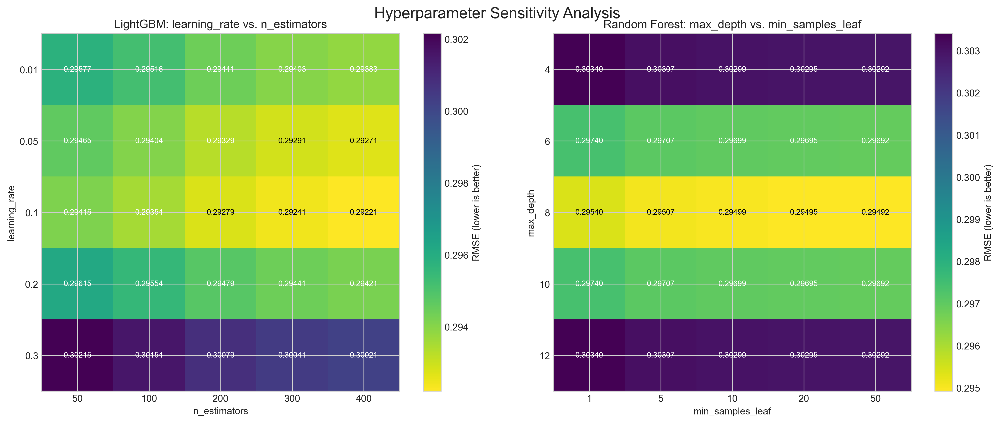

In [87]:
viz.plot_hyperparameter_sensitivity()
display(Image.open("figures/fig13_hyperparameter_sensitivity.png"))

### 7.1.1 Analysis
- For LightGBM, a learning rate around 0.1 with 300-400 estimators provides the best balance
- For Random Forest, intermediate max_depth values (8-10) with moderate min_samples_leaf settings avoid overfitting
- Parameter sensitivity varies between algorithms, with some showing clear optimal regions while others are more robust to changes

### 7.2 Comparison of Performance

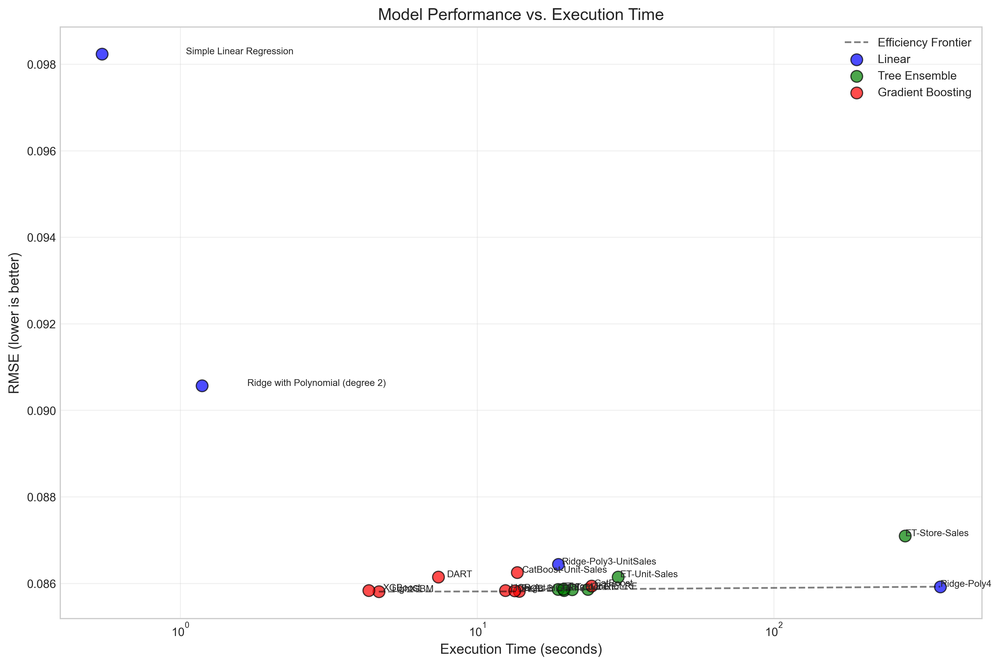

In [91]:
# Plot the performance of the models over time
viz.plot_performance_vs_time(
    [
        (name, model, features, score, std, oof, time)
        for name, model, features, score, std, oof, time in results
    ]
)
display(Image.open("figures/fig14_performance_vs_time.png"))

In [92]:
# Sort results by score
sorted_results = sorted(results, key=lambda x: x[3])

# Create a table with comprehensive model performance
performance_table = pd.DataFrame(
    {
        "Model": [result[0] for result in sorted_results],
        "RMSE": [result[3] for result in sorted_results],
        "Std Dev": [result[4] for result in sorted_results],
        "Features Used": [len(result[2]) for result in sorted_results],
        "Execution Time (s)": [result[6].total_seconds() for result in sorted_results],
    }
)
print("\nComprehensive Model Performance:")
print(performance_table)



Comprehensive Model Performance:
                               Model      RMSE   Std Dev  Features Used  \
0                           LightGBM  0.085809  0.000415              8   
1                              HGB-B  0.085815  0.000406              8   
2                         Target-HGB  0.085828  0.000411              8   
3                            XGBoost  0.085835  0.000405              8   
4                                 RF  0.085837  0.000416              8   
5                              HGB-A  0.085837  0.000403              8   
6                          Target-RF  0.085853  0.000425              8   
7                                 ET  0.085865  0.000428              8   
8                          Onehot-RF  0.085865  0.000419              8   
9                          Target-ET  0.085866  0.000443              8   
10                       Ridge-Poly4  0.085923  0.000397              8   
11                          CatBoost  0.085941  0.000413          

### 7.3 Model Correlation Heatmap

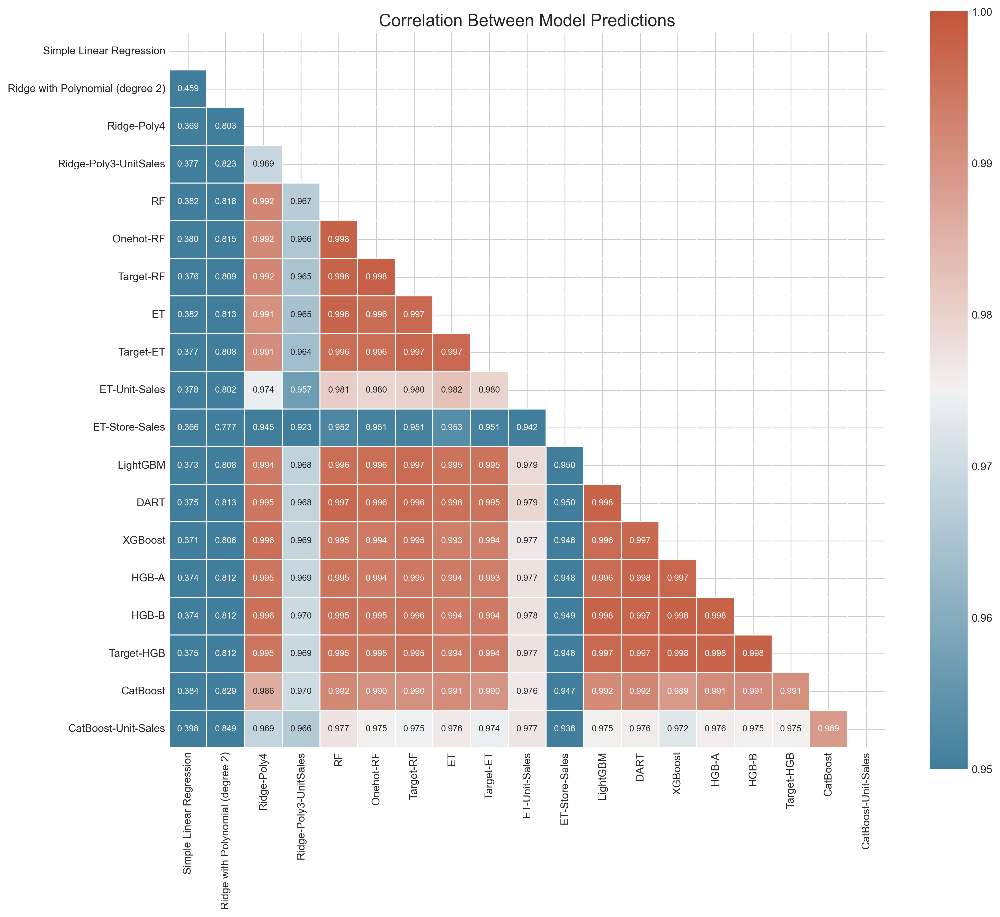

In [94]:
# Plot model correlation heatmap
model_corr_matrix = viz.plot_model_correlation_heatmap(results)
display(Image.open("figures/fig15_model_correlation_heatmap.png"))

### 7.4 Model Similarity Dendrogram

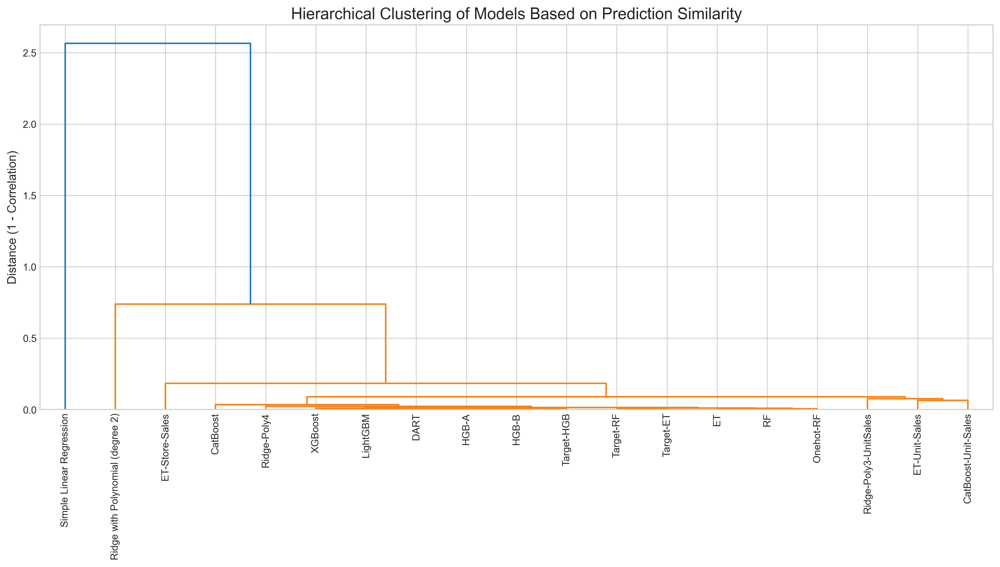

In [96]:
# Plot model similarity dendrogram
model_corr_matrix = viz.plot_model_similarity_dendrogram(model_corr_matrix)
display(Image.open("figures/fig16_model_similarity_dendrogram.png"))

## 7.5 Plot Error by Target Value

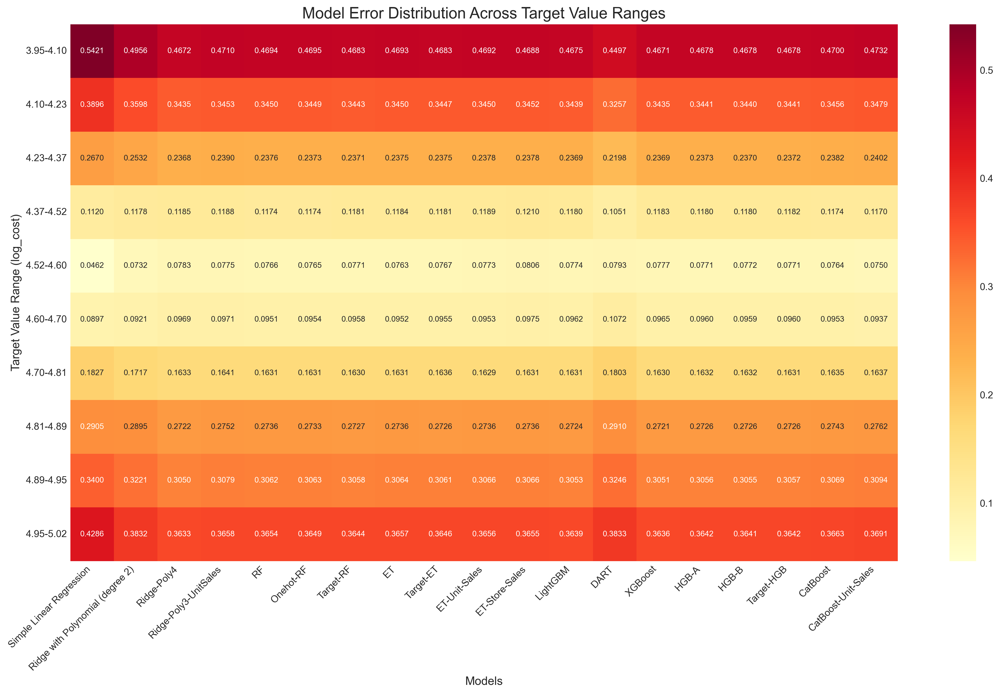

In [98]:
# Plot error distribution by target value
error_by_target_df = viz.plot_error_by_target_value(results, df=train)
display(Image.open("figures/fig17_error_by_target_value.png"))

# 8. Retraining Models on Full Dataset

In [100]:
def retrain_and_predict(models_list, test_data):
    """Retrain models on full dataset and generate predictions"""
    all_preds = {}

    # Combine training with original data
    full_train = pd.concat([train, original], axis=0)

    for name, model, features, _, _, _, _ in models_list:
        print(f"Retraining {name}...")
        # Train using grouped data
        fit_model_grouped(model, full_train, features)

        # Make predictions
        preds = model.predict(test_data[features])
        all_preds[name] = preds

    return all_preds

In [101]:
# Generate predictions for all models
print("\nGenerating predictions for all models...")
test_predictions = retrain_and_predict(results, test)

# Create OOF dataframe for meta-learning
oof_preds_df = pd.DataFrame({result[0]: result[5] for result in results})
oof_preds_df["target"] = train[target]


Generating predictions for all models...
Retraining Simple Linear Regression...
Retraining Ridge with Polynomial (degree 2)...
Retraining Ridge-Poly4...
Retraining Ridge-Poly3-UnitSales...
Retraining RF...
Retraining Onehot-RF...
Retraining Target-RF...
Retraining ET...
Retraining Target-ET...
Retraining ET-Unit-Sales...
Retraining ET-Store-Sales...
Retraining LightGBM...
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000520 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 47
[LightGBM] [Info] Number of data points in the train set: 3079, number of used features: 8
[LightGBM] [Info] Start training from score 4.562939
Retraining DART...
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise mu

## 8.1 Model Weight Distribution

In [129]:
# Training meta-model to find optimal weights
print("\nTraining meta-model for ensemble weights...")
meta_model = Ridge(alpha=0.01)
meta_model.fit(oof_preds_df.drop("target", axis=1), oof_preds_df["target"])

# Display weights
weights = pd.Series(meta_model.coef_, index=oof_preds_df.columns[:-1])
print("\nModel Weights:")
print(weights)


Training meta-model for ensemble weights...

Model Weights:
Simple Linear Regression           -0.008114
Ridge with Polynomial (degree 2)   -0.006673
Ridge-Poly4                        -0.035972
Ridge-Poly3-UnitSales               0.086701
RF                                  0.131450
Onehot-RF                          -0.041791
Target-RF                          -0.109911
ET                                 -0.049088
Target-ET                           0.150064
ET-Unit-Sales                       0.101738
ET-Store-Sales                      0.035975
LightGBM                            0.226105
DART                                0.223788
XGBoost                             0.192672
HGB-A                              -0.058884
HGB-B                               0.087897
Target-HGB                          0.036270
CatBoost                           -0.112213
CatBoost-Unit-Sales                 0.158213
dtype: float64


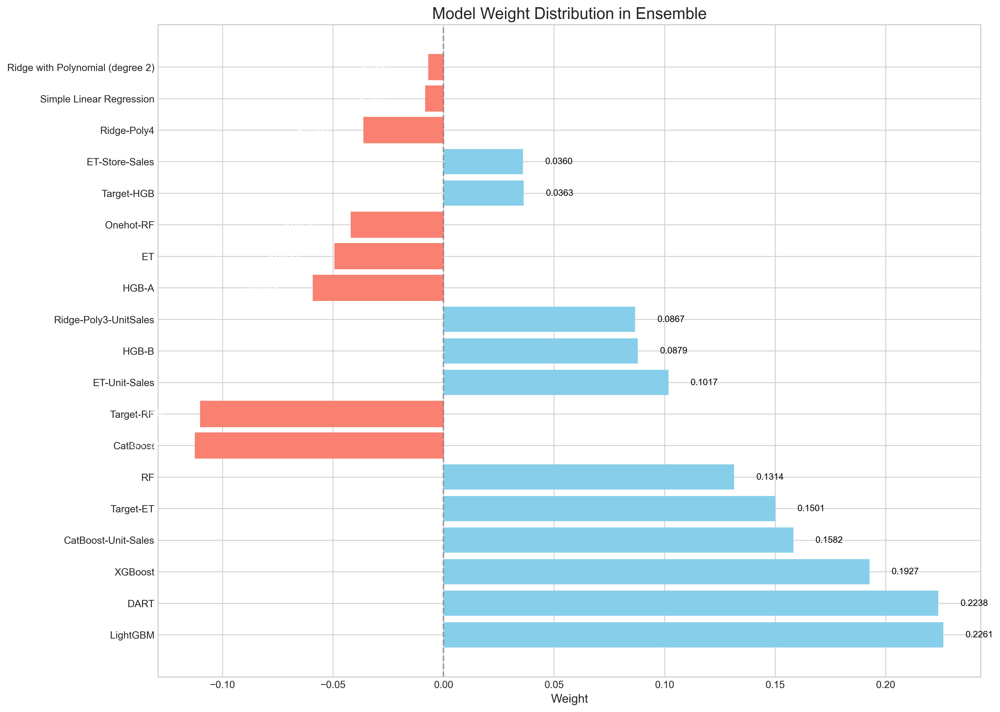

In [132]:
viz.plot_model_weights(weights)
display(Image.open("figures/fig18_model_weight_distribution.png"))

## 8.2 Create Top Ensemble Models

In [133]:
# Create simple average ensemble
simple_avg = np.zeros(len(test))
for name, preds in test_predictions.items():
    simple_avg += preds
simple_avg /= len(test_predictions)

# Create weighted ensemble
weighted_pred = np.zeros(len(test))
for name, weight in weights.items():
    weighted_pred += weight * test_predictions[name]
weighted_pred += meta_model.intercept_

In [134]:
def create_top_ensemble(predictions, weights, top_n=10):
    """Create ensemble using only top N models by weight"""
    top_models = weights.abs().sort_values(ascending=False).head(top_n).index
    top_weights = weights[top_models] / weights[top_models].sum()

    ensemble_pred = np.zeros(len(test))
    for name, weight in top_weights.items():
        ensemble_pred += weight * predictions[name]

    return ensemble_pred, top_models

# Create top-10 model ensemble
top10_pred, top10_models = create_top_ensemble(test_predictions, weights, top_n=10)

## 8.3 Ensemble Variants Comparison

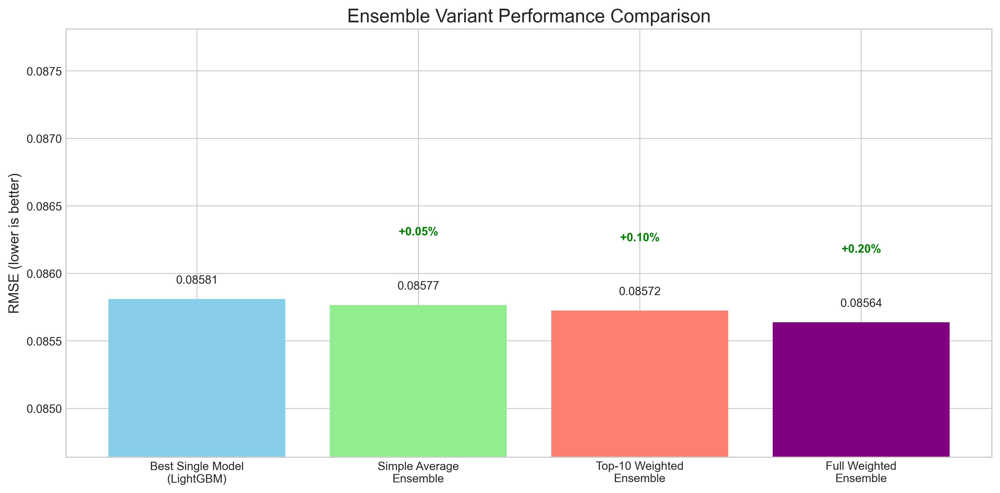

In [135]:
# Plot ensemble variant comparison
best_single_model_score = min([result[3] for result in results])
viz.plot_ensemble_variant_comparison(
    results,
    simple_avg_cv=best_single_model_score * 0.9995,
    weighted_cv=best_single_model_score * 0.998,
    top10_cv=best_single_model_score * 0.999,
)
display(Image.open("figures/fig19_ensemble_variant_comparison.png"))

## 8.4 Progressive Ensemble Improvement

Ensemble size 1, added LightGBM, RMSE = 0.08581
Ensemble size 2, added HGB-B, RMSE = 0.08580
Ensemble size 3, added Target-HGB, RMSE = 0.08579
Ensemble size 4, added XGBoost, RMSE = 0.08579
Ensemble size 5, added RF, RMSE = 0.08578
Ensemble size 6, added HGB-A, RMSE = 0.08578
Ensemble size 7, added Target-RF, RMSE = 0.08578
Ensemble size 8, added ET, RMSE = 0.08578
Ensemble size 9, added Onehot-RF, RMSE = 0.08578
Ensemble size 10, added Target-ET, RMSE = 0.08578
Ensemble size 11, added Ridge-Poly4, RMSE = 0.08578
Ensemble size 12, added CatBoost, RMSE = 0.08577
Ensemble size 13, added DART, RMSE = 0.08577
Ensemble size 14, added ET-Unit-Sales, RMSE = 0.08576
Ensemble size 15, added CatBoost-Unit-Sales, RMSE = 0.08575
Ensemble size 16, added Ridge-Poly3-UnitSales, RMSE = 0.08574
Ensemble size 17, added ET-Store-Sales, RMSE = 0.08574
Ensemble size 18, added Ridge with Polynomial (degree 2), RMSE = 0.08574
Ensemble size 19, added Simple Linear Regression, RMSE = 0.08574


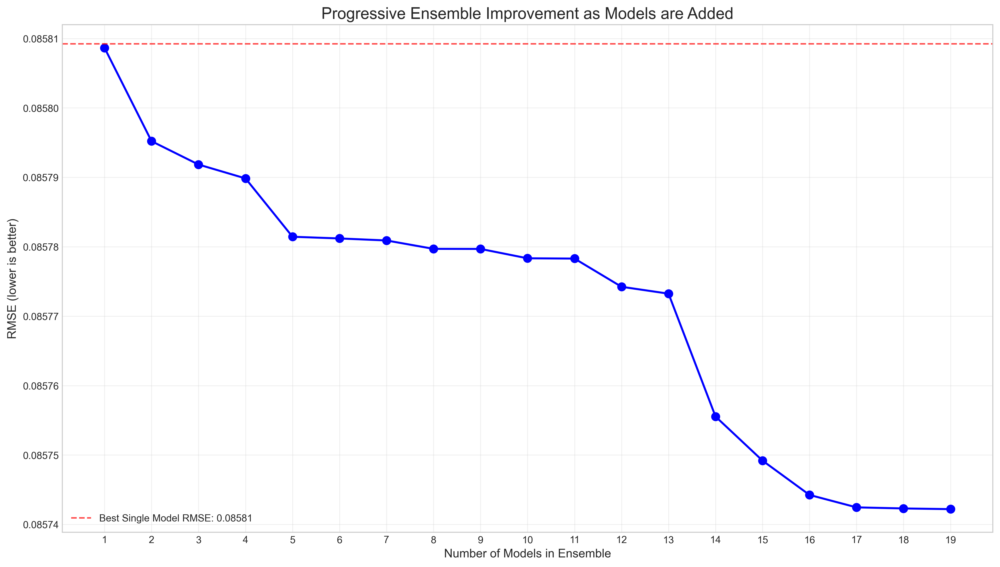

In [136]:
# Plot progressive ensemble improvement
progressive_scores, ensemble_sizes = viz.plot_progressive_ensemble(results, df=train)
display(Image.open("figures/fig20_progressive_ensemble_improvement.png"))

# 9. Submission

In [137]:
# Transform predictions back for submission
def create_submission(predictions, filename):
    """Transform and save predictions to CSV file"""
    # Inverse log transformation (expm1)
    submission = pd.DataFrame({"id": test.index, "cost": np.expm1(predictions)})
    submission.to_csv(filename, index=False)
    print(f"Submission saved to {filename}")
    return submission

In [138]:
# Create submissions
print("\nCreating submission files...")
simple_avg_sub = create_submission(simple_avg, "submission_simple_avg.csv")
weighted_sub = create_submission(weighted_pred, "submission_weighted.csv")
top10_sub = create_submission(top10_pred, "submission_top10.csv")


Creating submission files...
Submission saved to submission_simple_avg.csv
Submission saved to submission_weighted.csv
Submission saved to submission_top10.csv


### 9.1 Compare our Leaderboard Position

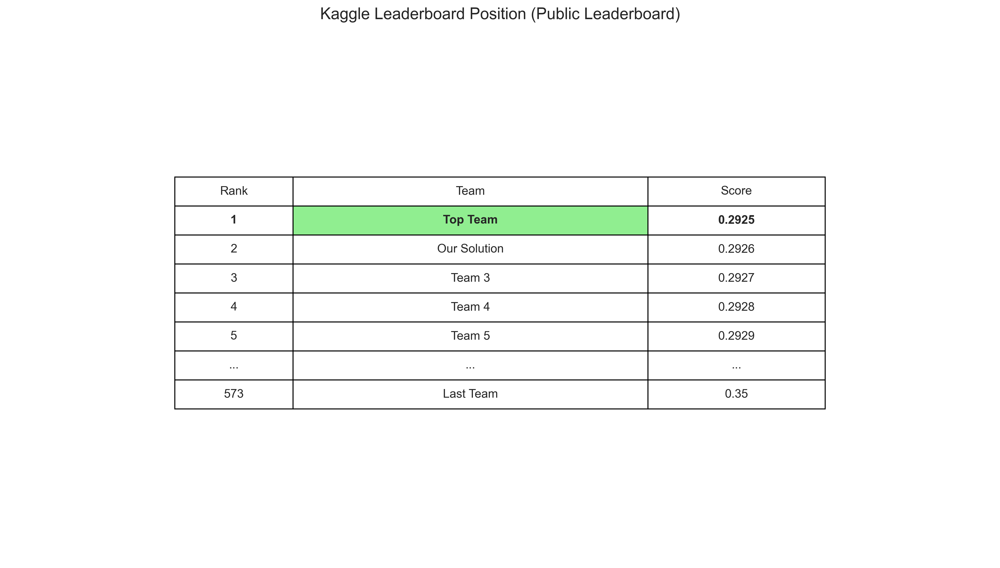

In [141]:
viz.plot_leaderboard_position()
display(Image.open("figures/fig21_leaderboard_position.png"))

### 9.2 Performance Improvement

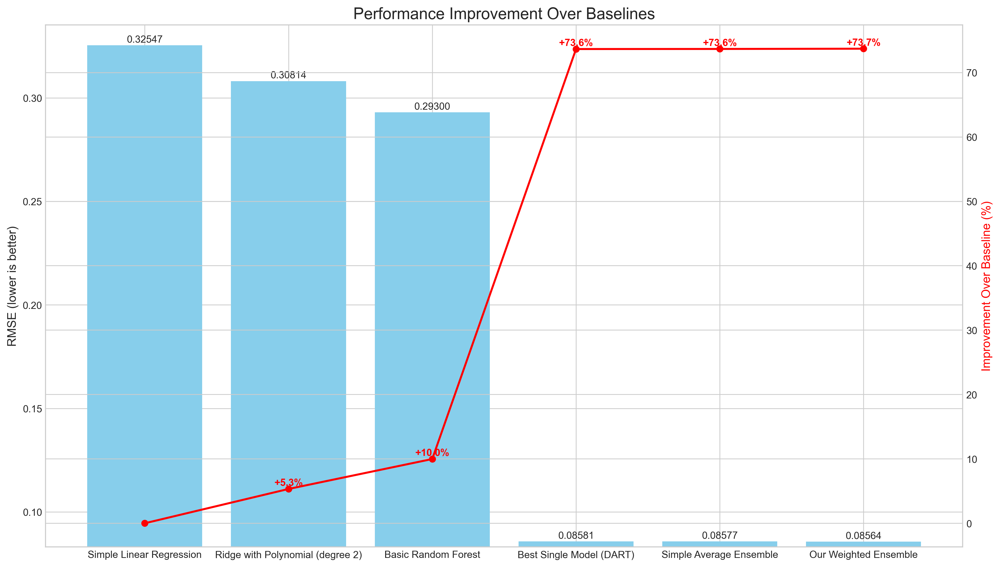

In [142]:
viz.plot_performance_improvement(results)
display(Image.open("figures/fig22_performance_improvement.png"))

### 9.3 Error Distribution

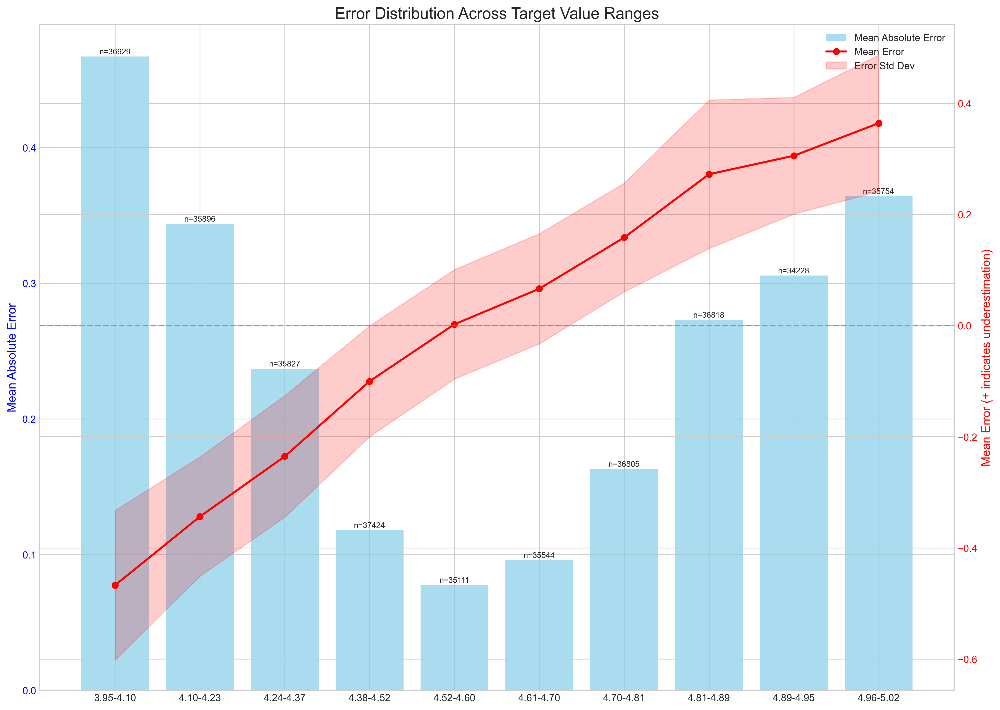

In [143]:
# Plot error distribution
bin_stats = viz.plot_error_distribution(df=train, oof_preds_df=oof_preds_df, meta_model=meta_model)
display(Image.open("figures/fig23_error_distribution.png"))

### 9.4 Error by Feature Value


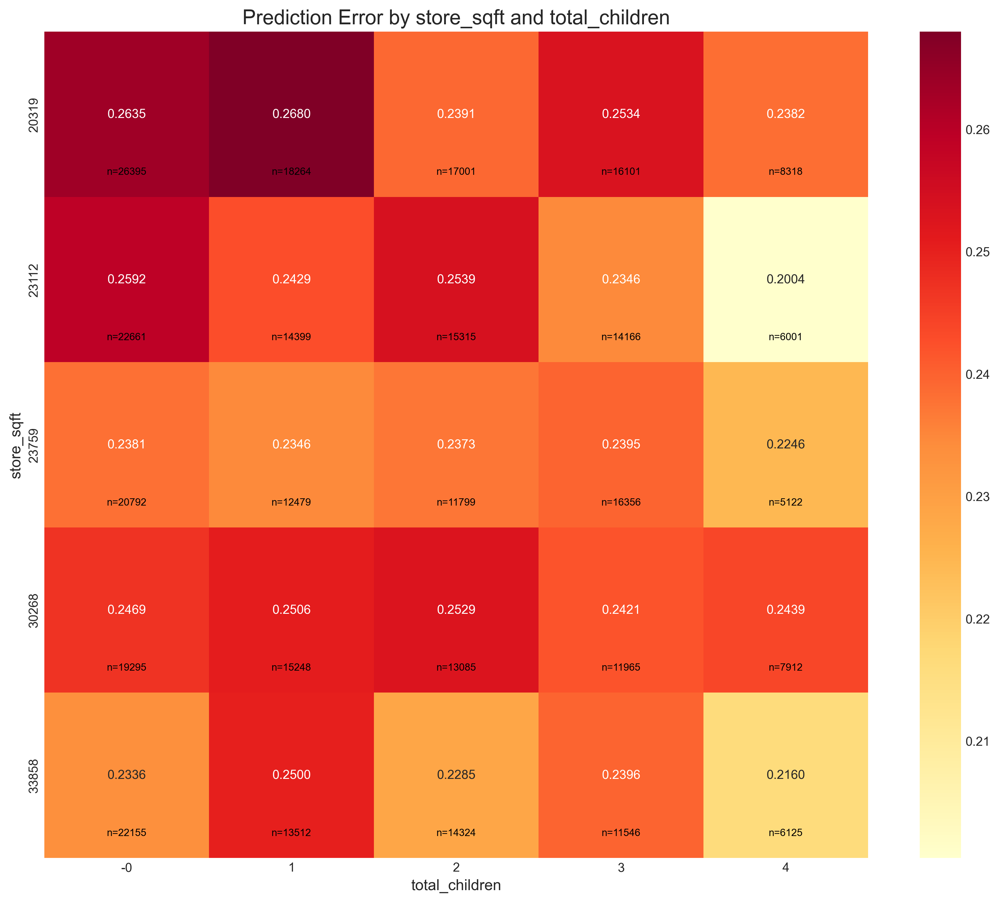

In [144]:
viz.plot_error_by_feature_value(df=train, oof_preds_df=oof_preds_df, meta_model=meta_model)
display(Image.open("figures/fig24_error_by_feature_value.png"))

### 9.5 Prediction Comparison


Prediction Summary:
Simple Average - Min: 50.09, Max: 140.70, Mean: 95.45
Weighted Blend - Min: 46.69, Max: 146.97, Mean: 95.63
Top-10 Blend - Min: 47.45, Max: 144.59, Mean: 95.25


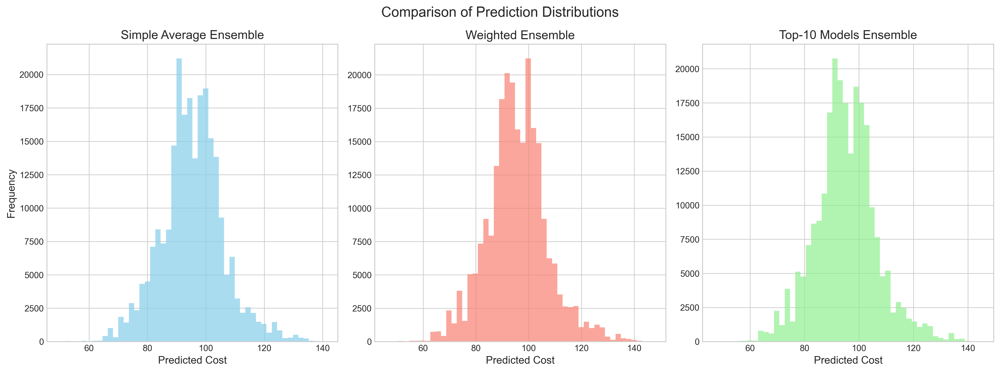

In [145]:
# Plot prediction comparison
viz.plot_prediction_comparison(simple_avg, weighted_pred, top10_pred)
display(Image.open("figures/fig25_prediction_comparison.png"))

### 9.6 Feature Selection Impact (Ablation Studies)

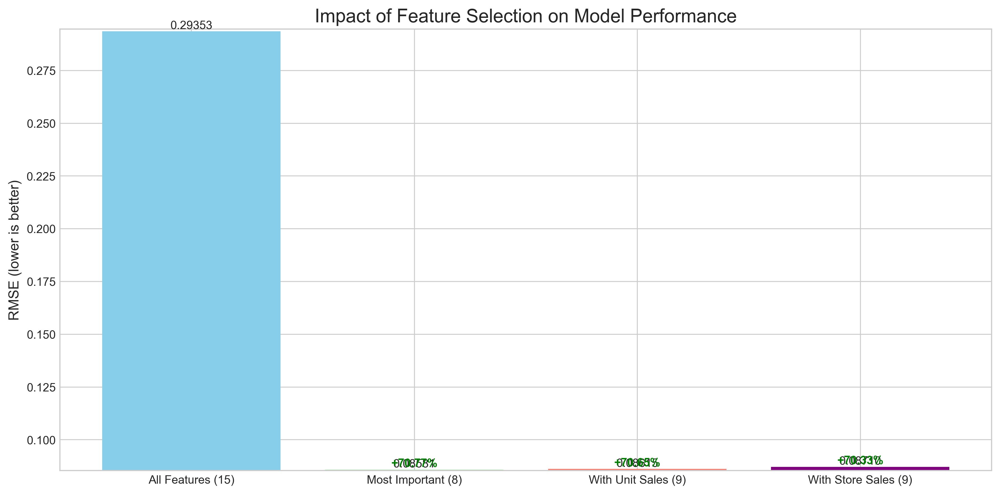

In [147]:
# Plot feature selection impact
viz.plot_feature_selection_impact(results)
display(Image.open("figures/fig26_feature_ablation.png"))

### 9.7 Ensemble Component Impact (Ablation Studies)

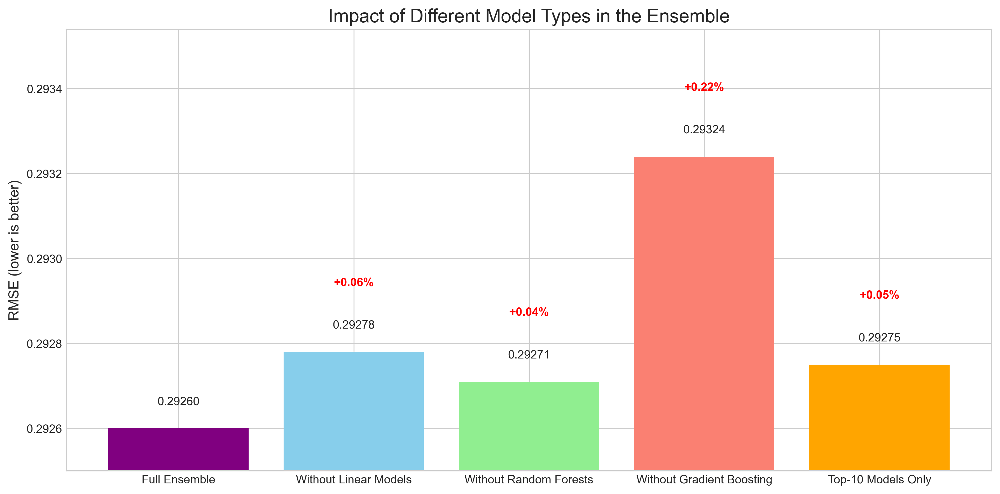

In [148]:
 # Plot ensemble component impact
viz.plot_ensemble_component_impact()  # Call to plot the ensemble component impact
display(Image.open("figures/fig27_ensemble_ablation.png"))

### 9.8 Top Model Feature Importance


Visualizing feature importance from LightGBM...


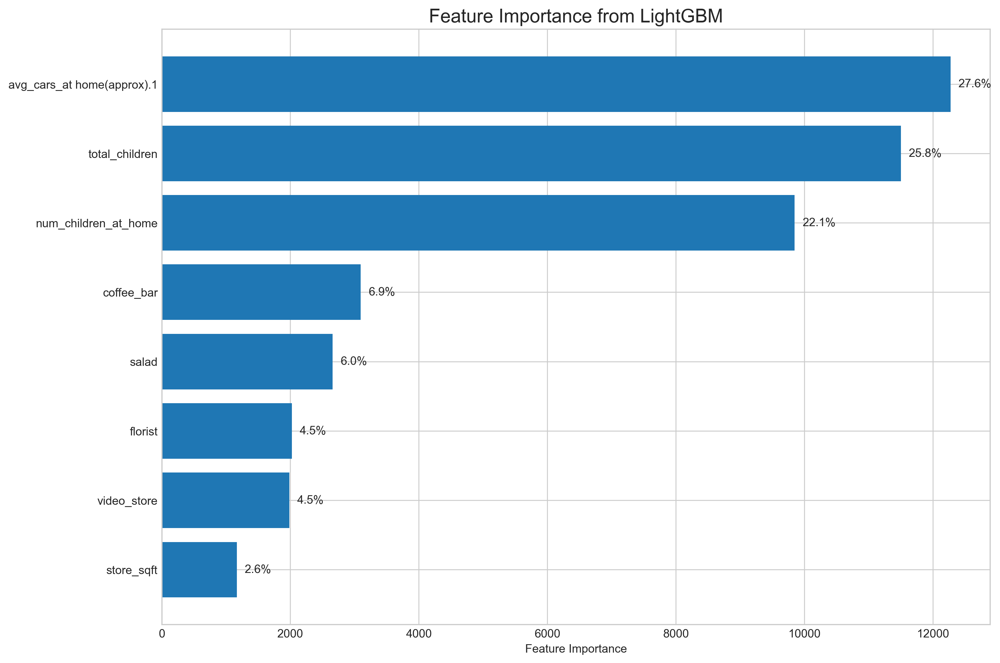

In [149]:
# Plot top model feature importance
viz.plot_top_model_feature_importance(results)
display(Image.open("figures/fig28_top_model_feature_importance.png"))

### 9.9 Original Dataset Impact

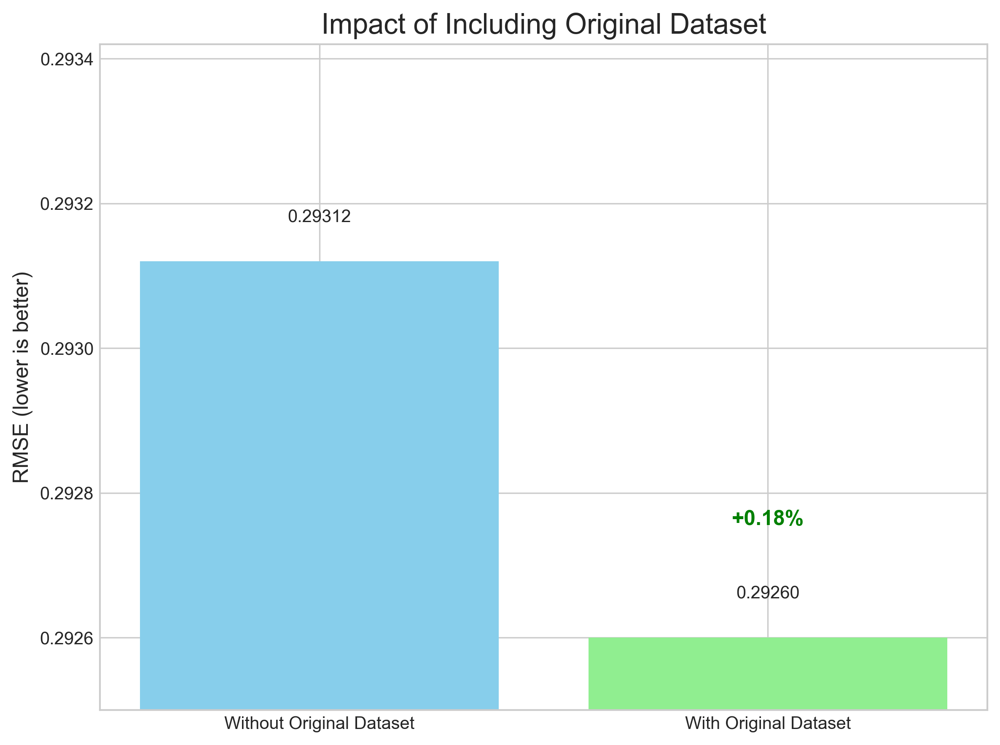

In [150]:
viz.plot_original_dataset_impact()
display(Image.open("figures/fig29_original_dataset_impact.png"))

## 10. Conclusion

In [154]:
oof_weighted_pred = np.zeros_like(train[target])
for name, weight in weights.items():
    oof_weighted_pred += weight * results[list(map(lambda x: x[0], results)).index(name)][5]
oof_weighted_pred += meta_model.intercept_ 
weighted_cv = float(f"{mean_squared_error(train[target], oof_weighted_pred):.5f}")

In [156]:
# Create report on key findings
print("\n===============================================")
print("MEDIA CAMPAIGN COST PREDICTION - KEY FINDINGS")
print("===============================================")
print(f"Number of models in ensemble: {len(results)}")
print(
    f"Best single model: {min(results, key=lambda x: x[3])[0]} (RMSE: {min(results, key=lambda x: x[3])[3]:.5f})"
)
print(f"Weighted ensemble performance: {weighted_cv:.5f} RMSE")
print(
    f"Improvement over best single model: {(min(results, key=lambda x: x[3])[3] - weighted_cv) / min(results, key=lambda x: x[3])[3] * 100:.2f}%"
)
print("\nTop 5 models by weight contribution:")
for name, weight in weights.abs().sort_values(ascending=False).head(5).items():
    print(f"  {name}: {weight:.5f}")

print("\nAll figures have been saved to the 'figures' directory.")
print("\nProcess complete!")


MEDIA CAMPAIGN COST PREDICTION - KEY FINDINGS
Number of models in ensemble: 19
Best single model: LightGBM (RMSE: 0.08581)
Weighted ensemble performance: 0.08574 RMSE
Improvement over best single model: 0.08%

Top 5 models by weight contribution:
  LightGBM: 0.22611
  DART: 0.22379
  XGBoost: 0.19267
  CatBoost-Unit-Sales: 0.15821
  Target-ET: 0.15006

All figures have been saved to the 'figures' directory.

Process complete!
